<img align="left" src="https://lever-client-logos.s3.amazonaws.com/864372b1-534c-480e-acd5-9711f850815c-1524247202159.png" width=200>
<br></br>
<br></br>

# Major Neural Network Architectures Challenge
## *Data Science Unit 4 Sprint 3 Challenge*

In this sprint challenge, you'll explore some of the cutting edge of Data Science. This week we studied several famous neural network architectures: 
recurrent neural networks (RNNs), long short-term memory (LSTMs), convolutional neural networks (CNNs), and Generative Adverserial Networks (GANs). In this sprint challenge, you will revisit these models. Remember, we are testing your knowledge of these architectures not your ability to fit a model with high accuracy. 

__*Caution:*__  these approaches can be pretty heavy computationally. All problems were designed so that you should be able to achieve results within at most 5-10 minutes of runtime on Colab or a comparable environment. If something is running longer, doublecheck your approach!

## Challenge Objectives
*You should be able to:*
* <a href="#p1">Part 1</a>: Train a RNN classification model
* <a href="#p2">Part 2</a>: Utilize a pre-trained CNN for objective detection
* <a href="#p3">Part 3</a>: Describe the difference between a discriminator and generator in a GAN
* <a href="#p4">Part 4</a>: Describe yourself as a Data Science and elucidate your vision of AI

<a id="p1"></a>
## Part 1 - RNNs

Use an RNN to fit a multi-class classification model on reuters news articles to distinguish topics of articles. The data is already encoded properly for use in an RNN model. 

Your Tasks: 
- Use Keras to fit a predictive model, classifying news articles into topics. 
- Report your overall score and accuracy

For reference, the [Keras IMDB sentiment classification example](https://github.com/keras-team/keras/blob/master/examples/imdb_lstm.py) will be useful, as well the RNN code we used in class.

__*Note:*__  Focus on getting a running model, not on maxing accuracy with extreme data size or epoch numbers. Only revisit and push accuracy if you get everything else done!

In [20]:
from tensorflow.keras.datasets import reuters

(x_train, y_train), (x_test, y_test) = reuters.load_data(num_words=None,
                                                         skip_top=0,
                                                         maxlen=None,
                                                         test_split=0.2,
                                                         seed=723812,
                                                         start_char=1,
                                                         oov_char=2,
                                                         index_from=3)

In [21]:
# Demo of encoding

# we got the indices before now we get the word index from reuters word index.json

word_index = reuters.get_word_index(path="reuters_word_index.json")

print(f"Iran is encoded as {word_index['iran']} in the data")
print(f"London is encoded as {word_index['london']} in the data")
print("Words are encoded as numbers in our dataset.")

Iran is encoded as 779 in the data
London is encoded as 544 in the data
Words are encoded as numbers in our dataset.


In [22]:
print('# of training samples: {}'.format(len(x_train)))
print('# of text samples: {}'.format(len(x_test)))

num_classes = max(y_train) + 1
print('# of classes: {}'.format(num_classes))



# of training samples: 8982
# of text samples: 2246
# of classes: 46


In [23]:
print(x_train[0])
print(y_train[0])



[1, 248, 409, 166, 265, 1537, 1662, 8, 24, 4, 1222, 2771, 7, 227, 236, 40, 85, 944, 10, 531, 176, 8, 4, 176, 1613, 24, 1662, 297, 5157, 6, 10, 103, 5, 231, 215, 8, 7, 2889, 6, 10, 1202, 69, 4, 1222, 329, 2771, 24, 944, 23, 944, 1662, 40, 2509, 1592, 907, 69, 4, 113, 997, 762, 2539, 7, 227, 236, 17, 12]
19


In [24]:
# let's see which words are the most common:
print('pak:',word_index['pakistan'])

#print('us:', word_index['united states'])

print('peace:', word_index['peace'])

print('computer: ', word_index['computer'])

print('const:', word_index['constitution'])


pak: 2804
peace: 11269
computer:  803
const: 14953


In [27]:
from keras.preprocessing.text import Tokenizer

max_words = 10000
tokenizer = Tokenizer(num_words =max_words)
x_train = tokenizer.sequences_to_matrix(x_train, mode='binary')
x_test = tokenizer.sequences_to_matrix(x_test, mode='binary')


ValueError: The truth value of an array with more than one element is ambiguous. Use a.any() or a.all()

In [28]:
# let's do the same with y_test
import keras 
y_train = keras.utils.to_categorical(y_train, num_classes)
y_test = keras.utils.to_categorical(y_test, num_classes)

In [29]:
print(x_train.shape)
print(x_train[0])

print(y_train.shape)
print(y_train[0])


(8982, 10000)
[0. 1. 0. ... 0. 0. 0.]
(8982, 46)
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]


In [35]:
from __future__ import print_function

from keras.preprocessing import sequence
from keras.models import Sequential
from keras.layers import Dense, Embedding, Activation, Dropout
from keras.layers import LSTM


print('Build model...')

model = Sequential()
model.add(Dense(512, input_shape=(max_words, )))
model.add(Activation('relu'))
model.add(Dropout(0.2))
model.add(Dense(num_classes))
model.add(Activation('softmax'))

model.compile(loss='categorical_crossentropy',
             optimizer='adam',
             metrics=['accuracy'])

batch_size = 64
epochs = 20

history = model.fit(x_train, y_train, batch_size=batch_size, epochs=epochs, verbose=1, validation_split=0.1)

score = model.evaluate(x_test,y_test,batch_size=batch_size, verbose=1)

print('test loss: {}'.format(score[0]))
print('Test accuracy: {}'.format(score[1]))



Build model...
Train on 8083 samples, validate on 899 samples
Epoch 1/20
8083/8083 [==============================] - 8s 1ms/step - loss: 1.3441 - acc: 0.7232 - val_loss: 0.9084 - val_acc: 0.8053
Epoch 2/20
8083/8083 [==============================] - 7s 824us/step - loss: 0.4436 - acc: 0.9023 - val_loss: 0.8893 - val_acc: 0.8042
Epoch 3/20
8083/8083 [==============================] - 7s 829us/step - loss: 0.2584 - acc: 0.9417 - val_loss: 0.9069 - val_acc: 0.8109
Epoch 4/20
8083/8083 [==============================] - 7s 809us/step - loss: 0.2033 - acc: 0.9525 - val_loss: 0.9294 - val_acc: 0.8087
Epoch 5/20
8083/8083 [==============================] - 7s 812us/step - loss: 0.1866 - acc: 0.9532 - val_loss: 0.9805 - val_acc: 0.7998
Epoch 6/20
8083/8083 [==============================] - 7s 829us/step - loss: 0.1669 - acc: 0.9558 - val_loss: 0.9787 - val_acc: 0.8053
Epoch 7/20
8083/8083 [==============================] - 7s 819us/step - loss: 0.1686 - acc: 0.9535 - val_loss: 0.9529 - val_

Conclusion - RNN runs, and gives pretty decent improvement over a naive model. To *really* improve the model, more playing with parameters would help. Also - RNN may well not be the best approach here, but it is at least a valid one.

<a id="p2"></a>
## Part 2- CNNs

### Find the Frog

Time to play "find the frog!" Use Keras and ResNet50 (pre-trained) to detect which of the following images contain frogs:

<img align="left" src="https://d3i6fh83elv35t.cloudfront.net/newshour/app/uploads/2017/03/GettyImages-654745934-1024x687.jpg" width=400>


In [36]:
!pip install google_images_download

    100% |████████████████████████████████| 911kB 25.6MB/s ta 0:00:01
  Running setup.py bdist_wheel for google-images-download ... done
  Stored in directory: /home/ec2-user/.cache/pip/wheels/1f/28/ad/f56e7061e1d2a9a1affe2f9c649c2570cb9198dd24ede0bbab
Successfully built google-images-download
You are using pip version 10.0.1, however version 19.2.1 is available.
You should consider upgrading via the 'pip install --upgrade pip' command.


In [42]:
from google_images_download import google_images_download

response = google_images_download.googleimagesdownload()
arguments = {"keywords": "animal pond", "limit": 50, "print_urls": True}
absolute_image_paths = response.download(arguments)


Item no.: 1 --> Item name = animal pond
Evaluating...
Starting Download...
Image URL: https://www.enchantedlearning.com/pgifs/Pondanimals.GIF
Completed Image ====> 1.Pondanimals.GIF
Image URL: https://i.ytimg.com/vi/NCbu0TND9vE/hqdefault.jpg
Completed Image ====> 2.hqdefault.jpg
Image URL: https://pklifescience.com/staticfiles/articles/images/PKLS4116_inline.png
Completed Image ====> 3.PKLS4116_inline.png
Image URL: https://get.pxhere.com/photo/water-animal-pond-wildlife-mammal-fish-eat-fauna-whiskers-vertebrate-otter-mink-marmot-sea-otter-mustelidae-1383482.jpg
URLError on an image...trying next one... Error: HTTP Error 503: Service Temporarily Unavailable
Image URL: https://www.pixoto.com/images-photography/animals/birds/birds-in-a-pond-5986310798966784.jpg
Completed Image ====> 4.birds-in-a-pond-5986310798966784.jpg
Image URL: https://pklifescience.com/staticfiles/articles/images/PKLS4116.png
Completed Image ====> 5.PKLS4116.png
Image URL: https://i.pinimg.com/originals/08/32/22/08

At time of writing at least a few do, but since the Internet changes - it is possible your 5 won't. You can easily verify yourself, and (once you have working code) increase the number of images you pull to be more sure of getting a frog. Your goal is to validly run ResNet50 on the input images - don't worry about tuning or improving the model.

*Hint* - ResNet 50 doesn't just return "frog". The three labels it has for frogs are: `bullfrog, tree frog, tailed frog`

*Stretch goal* - also check for fish.

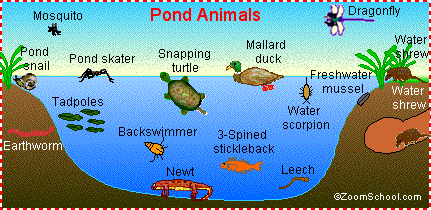

[('n03598930', 'jigsaw_puzzle', 0.86803216), ('n06359193', 'web_site', 0.064100005), ('n02834397', 'bib', 0.021264223)]


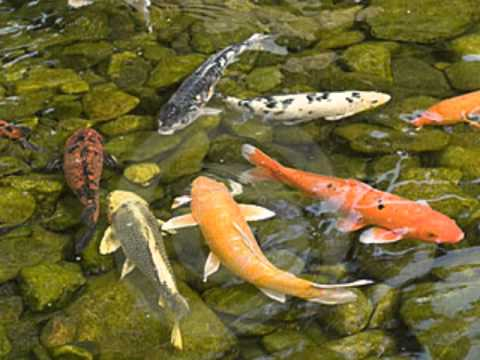

[('n01443537', 'goldfish', 0.8495909), ('n01631663', 'eft', 0.067602254), ('n02536864', 'coho', 0.035163656)]


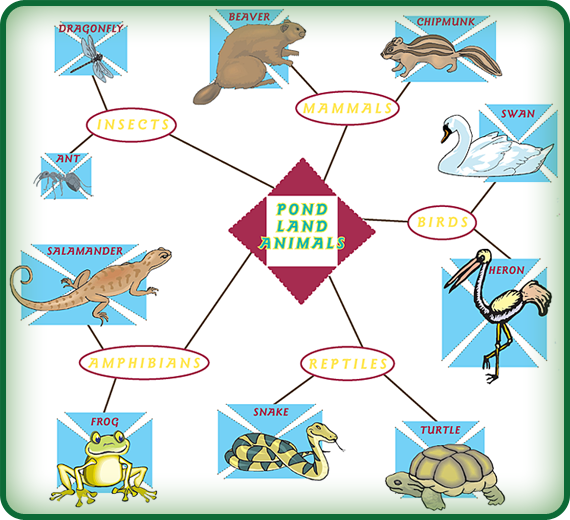

[('n04243546', 'slot', 0.8712447), ('n04476259', 'tray', 0.04993625), ('n03908618', 'pencil_box', 0.023072403)]


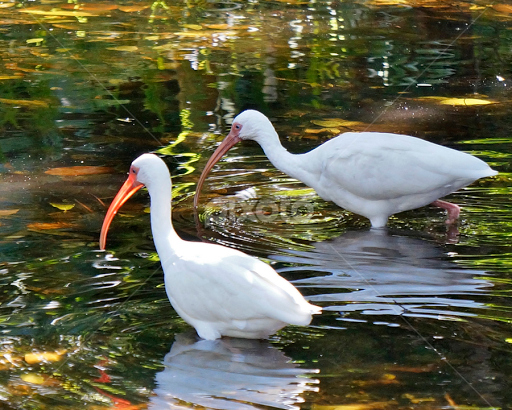

[('n02009912', 'American_egret', 0.7822419), ('n02012849', 'crane', 0.143392), ('n02009229', 'little_blue_heron', 0.021143444)]


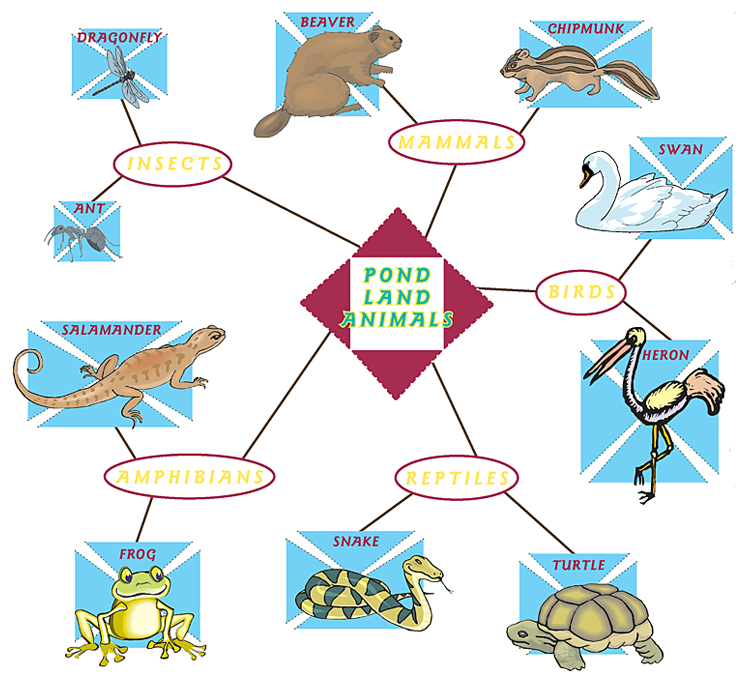

[('n03485794', 'handkerchief', 0.88227344), ('n02834397', 'bib', 0.022680784), ('n03291819', 'envelope', 0.020095093)]


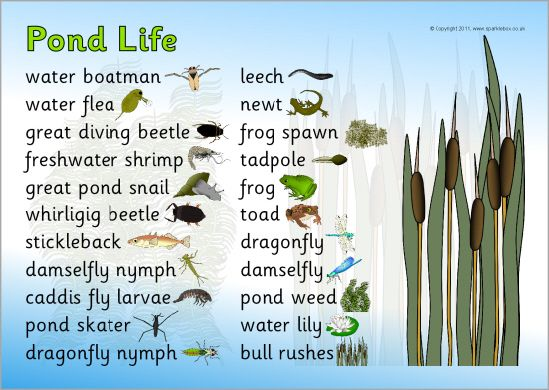

[('n06359193', 'web_site', 0.5092316), ('n02840245', 'binder', 0.10987016), ('n04209239', 'shower_curtain', 0.10011981)]


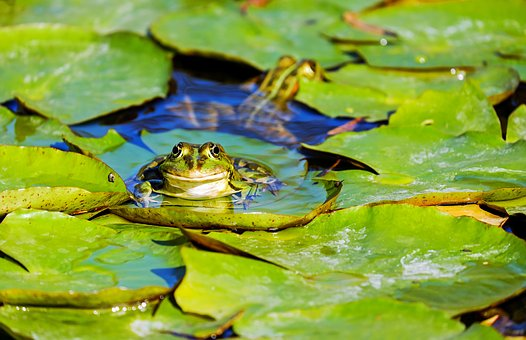

[('n01737021', 'water_snake', 0.3073062), ('n01641577', 'bullfrog', 0.2606137), ('n04275548', 'spider_web', 0.11343416)]


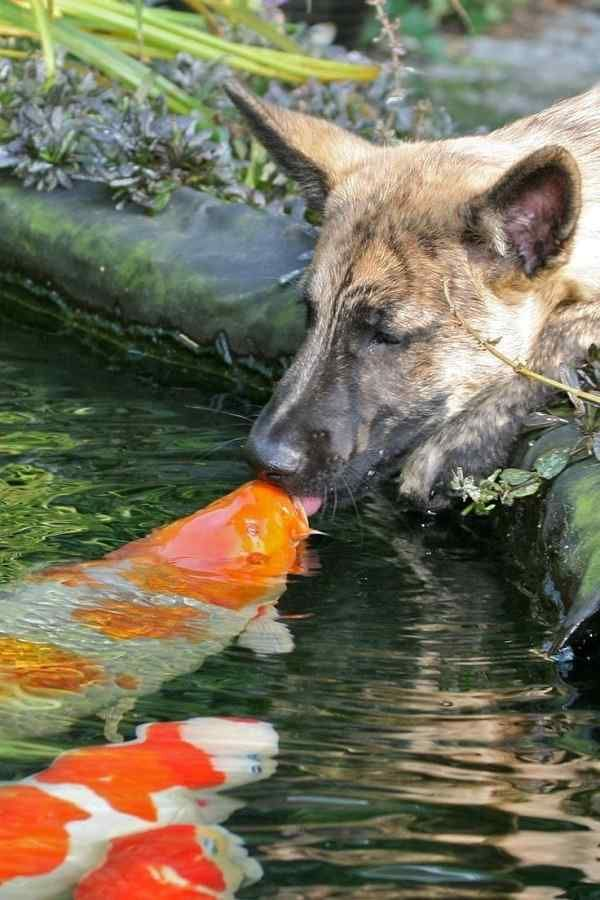

[('n02116738', 'African_hunting_dog', 0.6101576), ('n02105162', 'malinois', 0.19866847), ('n02114712', 'red_wolf', 0.05115344)]


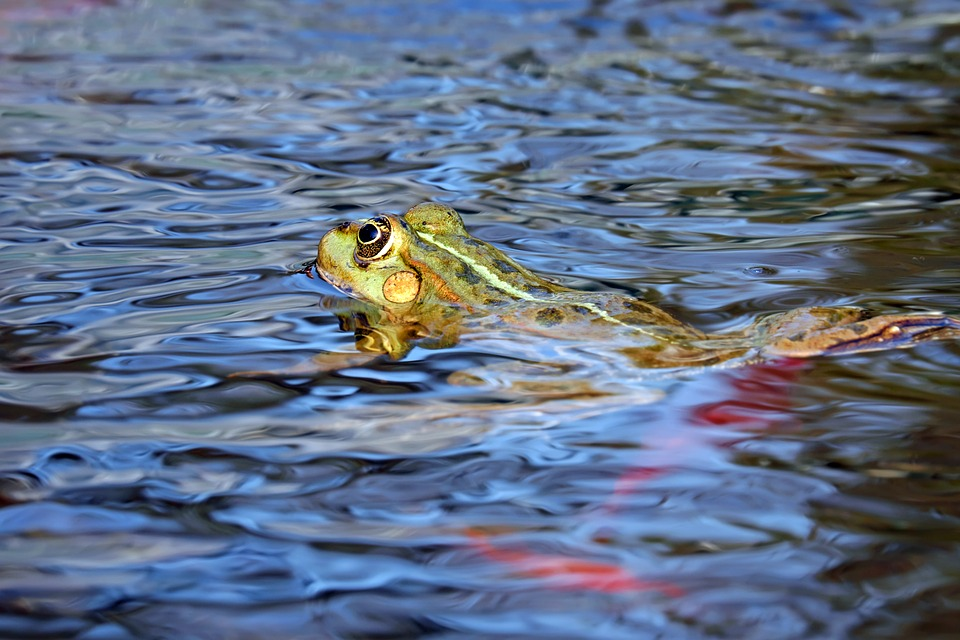

[('n01641577', 'bullfrog', 0.92233485), ('n01644900', 'tailed_frog', 0.07364671), ('n01644373', 'tree_frog', 0.0011781286)]


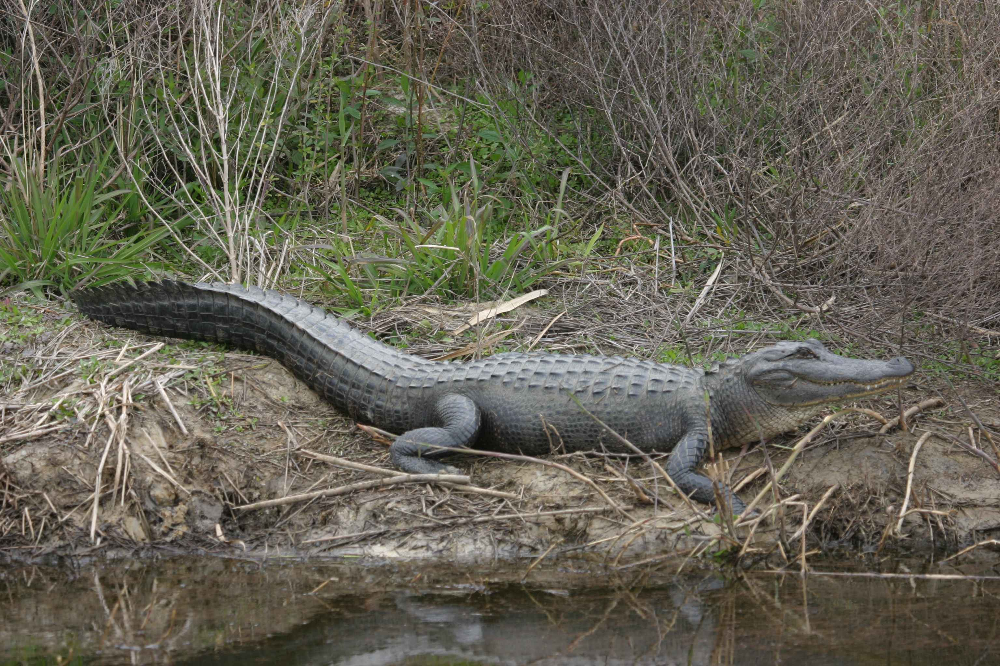

[('n01698640', 'American_alligator', 0.963947), ('n01697457', 'African_crocodile', 0.026759941), ('n01737021', 'water_snake', 0.005964695)]


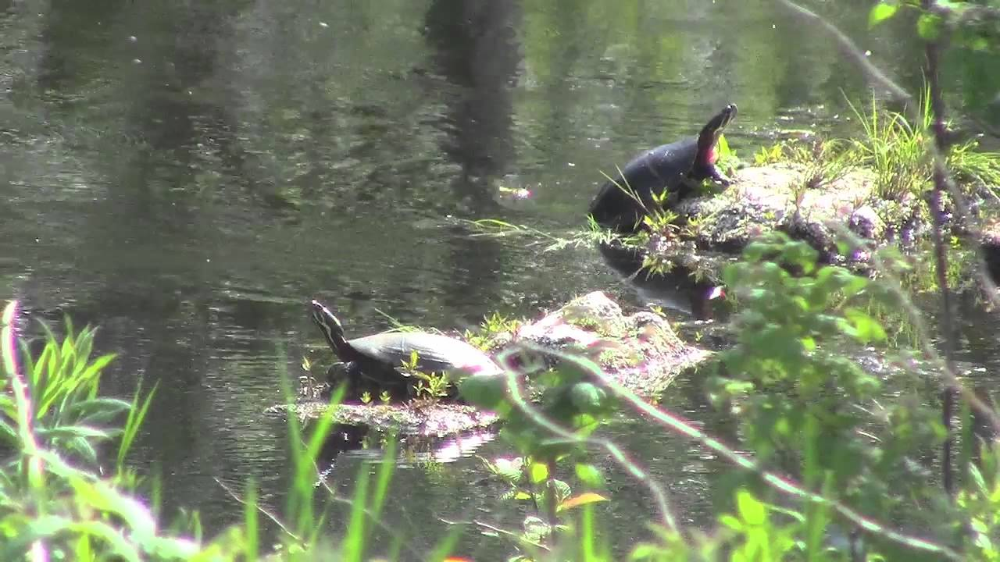

[('n02013706', 'limpkin', 0.3572373), ('n01806567', 'quail', 0.18107876), ('n02009229', 'little_blue_heron', 0.12651889)]


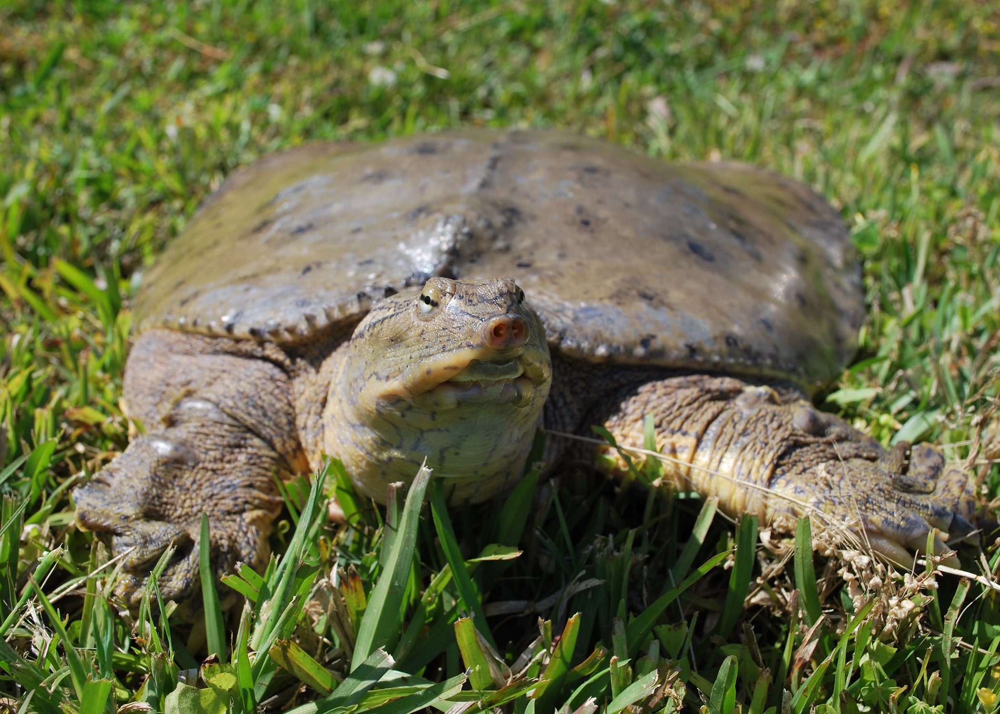

[('n01667778', 'terrapin', 0.4962105), ('n01667114', 'mud_turtle', 0.25764477), ('n01669191', 'box_turtle', 0.11115022)]


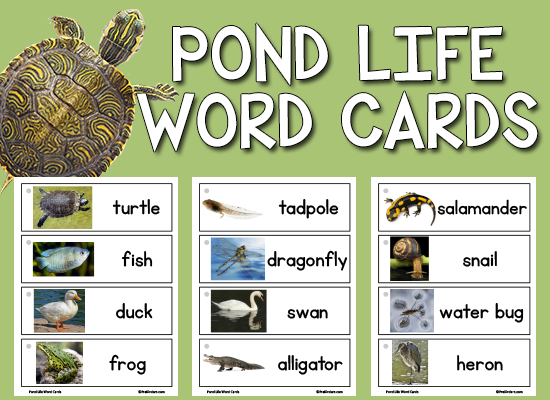

[('n06359193', 'web_site', 0.80454284), ('n02128385', 'leopard', 0.0122363055), ('n04243546', 'slot', 0.011795989)]


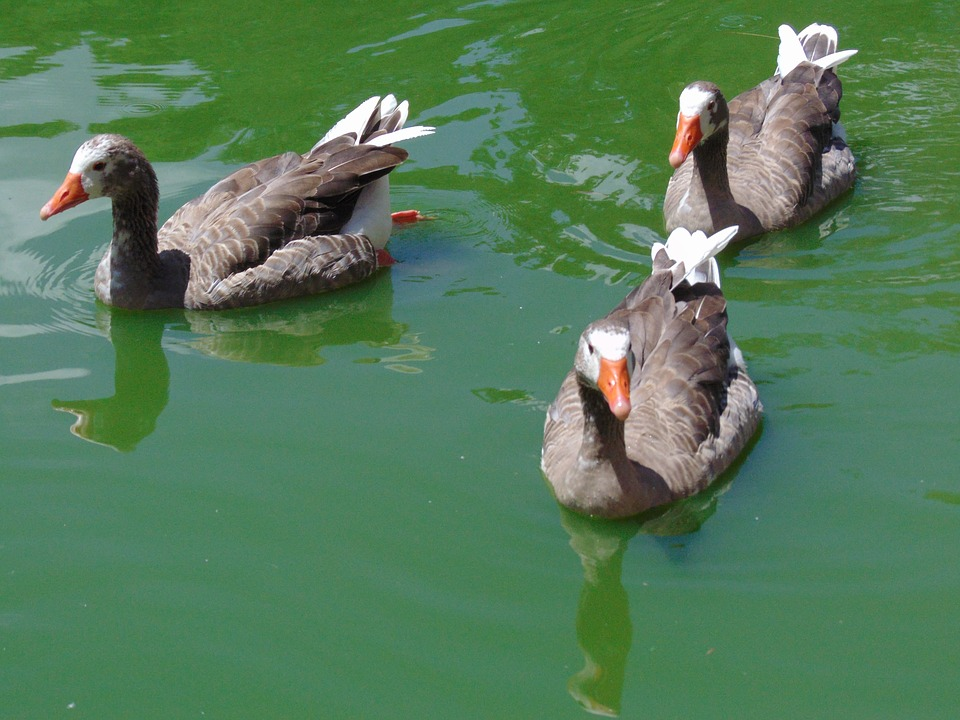

[('n01860187', 'black_swan', 0.87960774), ('n01847000', 'drake', 0.033985212), ('n01855032', 'red-breasted_merganser', 0.028971259)]


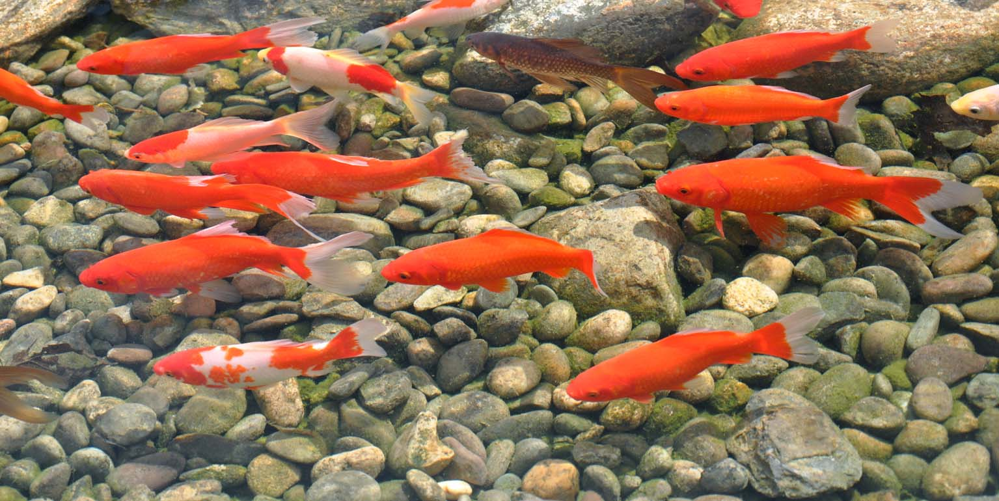

[('n01443537', 'goldfish', 0.94753873), ('n04596742', 'wok', 0.020672377), ('n09256479', 'coral_reef', 0.008456591)]


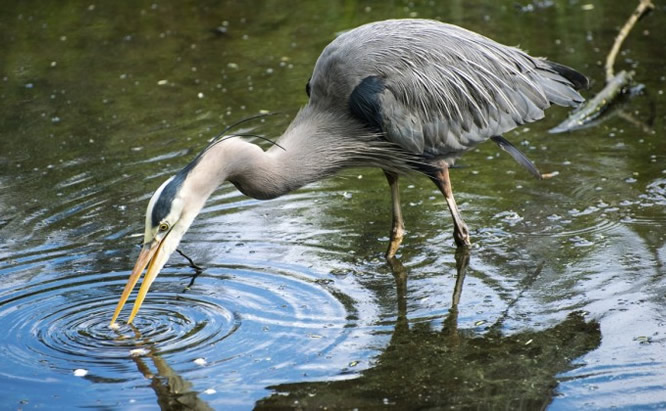

[('n02009229', 'little_blue_heron', 0.96752745), ('n02009912', 'American_egret', 0.0125888735), ('n02012849', 'crane', 0.00903466)]


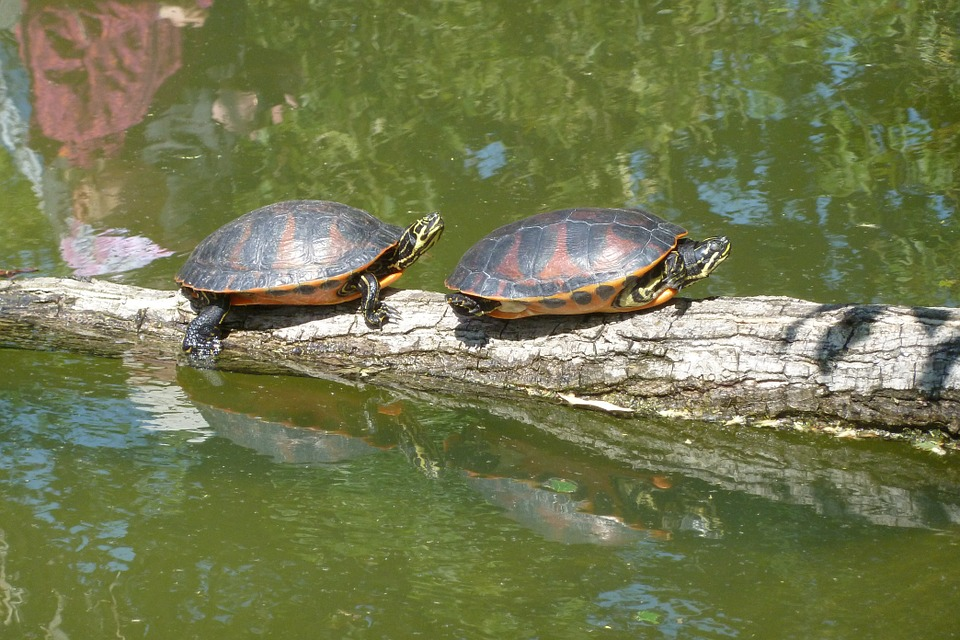

[('n01667778', 'terrapin', 0.6586793), ('n01667114', 'mud_turtle', 0.33384255), ('n01669191', 'box_turtle', 0.007462269)]


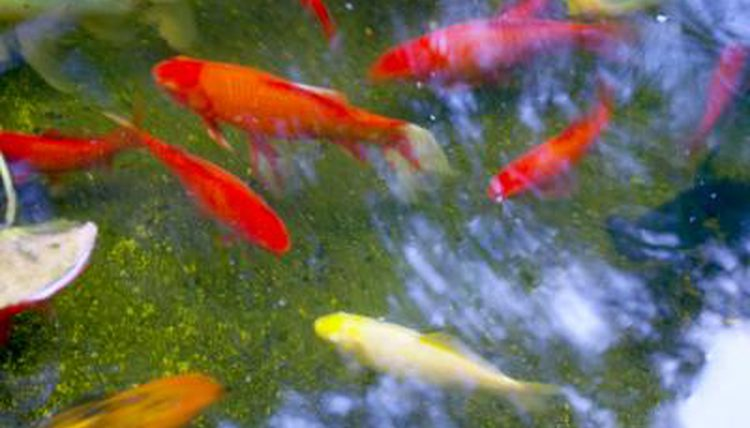

[('n01443537', 'goldfish', 0.95694625), ('n01833805', 'hummingbird', 0.009290768), ('n12620546', 'hip', 0.0034554468)]


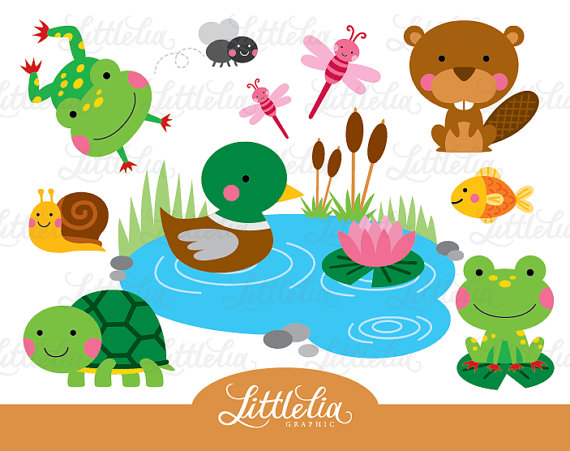

[('n02834397', 'bib', 0.16355726), ('n03485794', 'handkerchief', 0.13425848), ('n03291819', 'envelope', 0.11129378)]


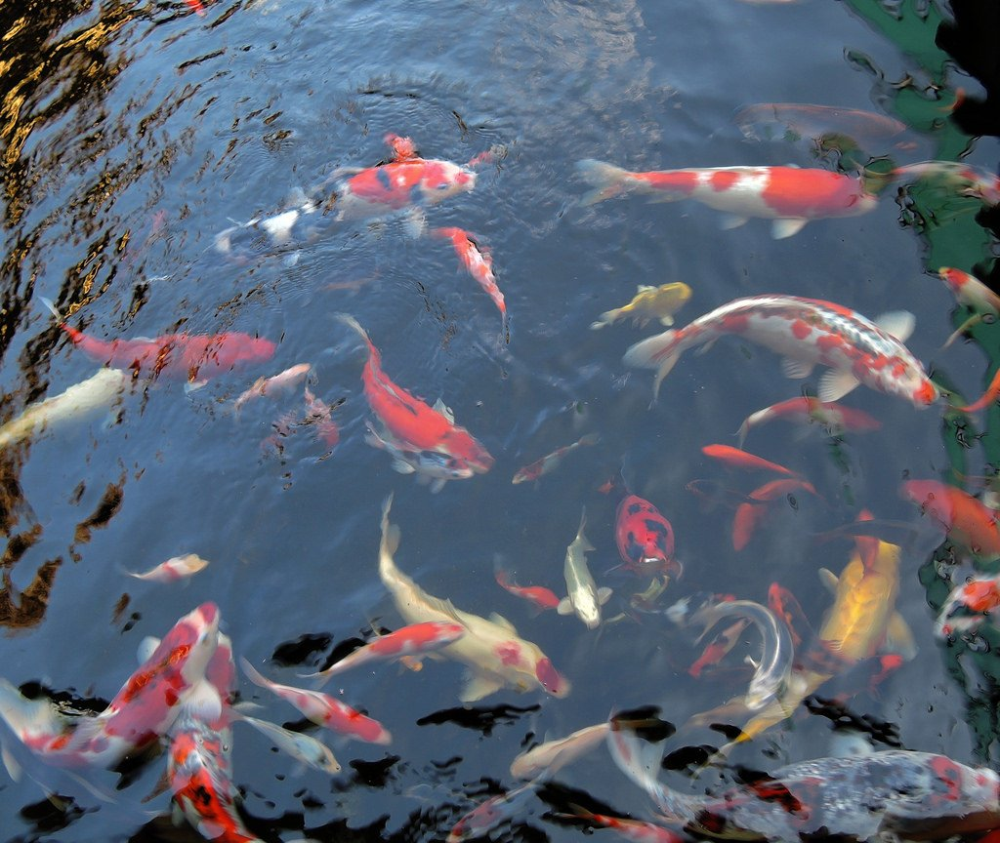

[('n01443537', 'goldfish', 0.99974805), ('n09472597', 'volcano', 9.606233e-05), ('n09256479', 'coral_reef', 7.421522e-05)]


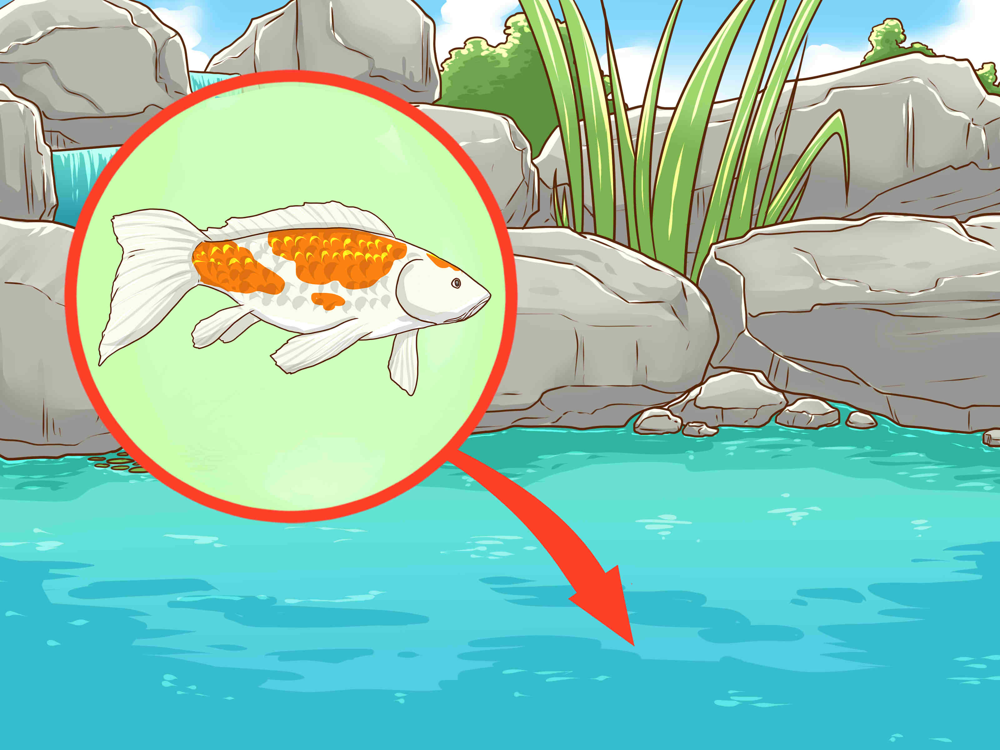

[('n04476259', 'tray', 0.23647523), ('n04259630', 'sombrero', 0.1878643), ('n03938244', 'pillow', 0.058250286)]


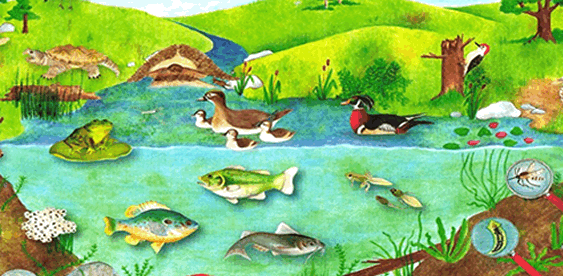

[('n03598930', 'jigsaw_puzzle', 0.21943669), ('n12998815', 'agaric', 0.052855626), ('n03874599', 'padlock', 0.048739668)]


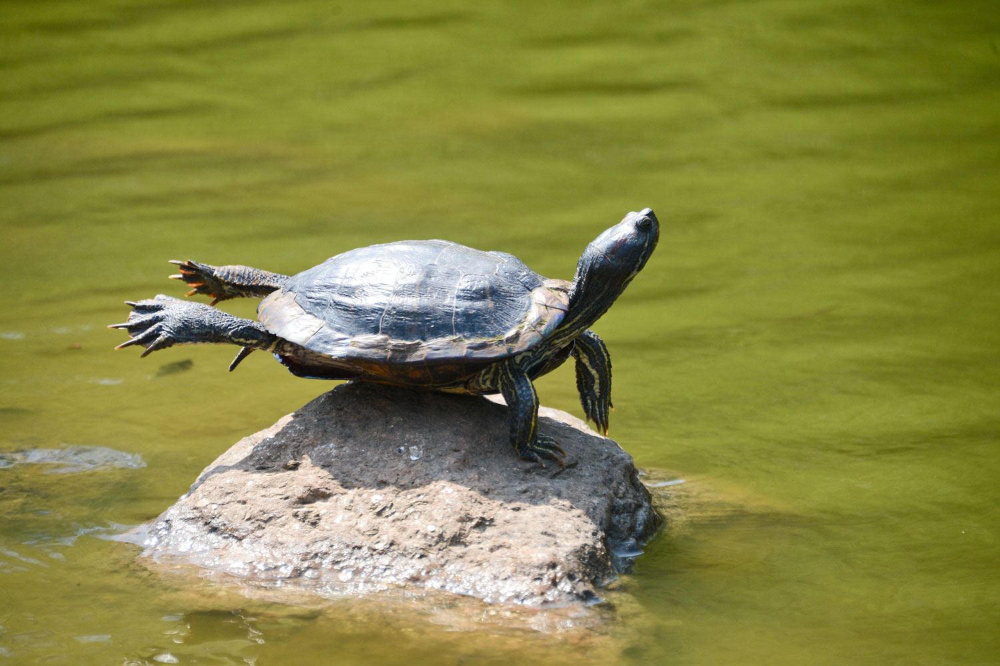

[('n01667778', 'terrapin', 0.54590255), ('n01667114', 'mud_turtle', 0.45357585), ('n01669191', 'box_turtle', 0.00049773604)]


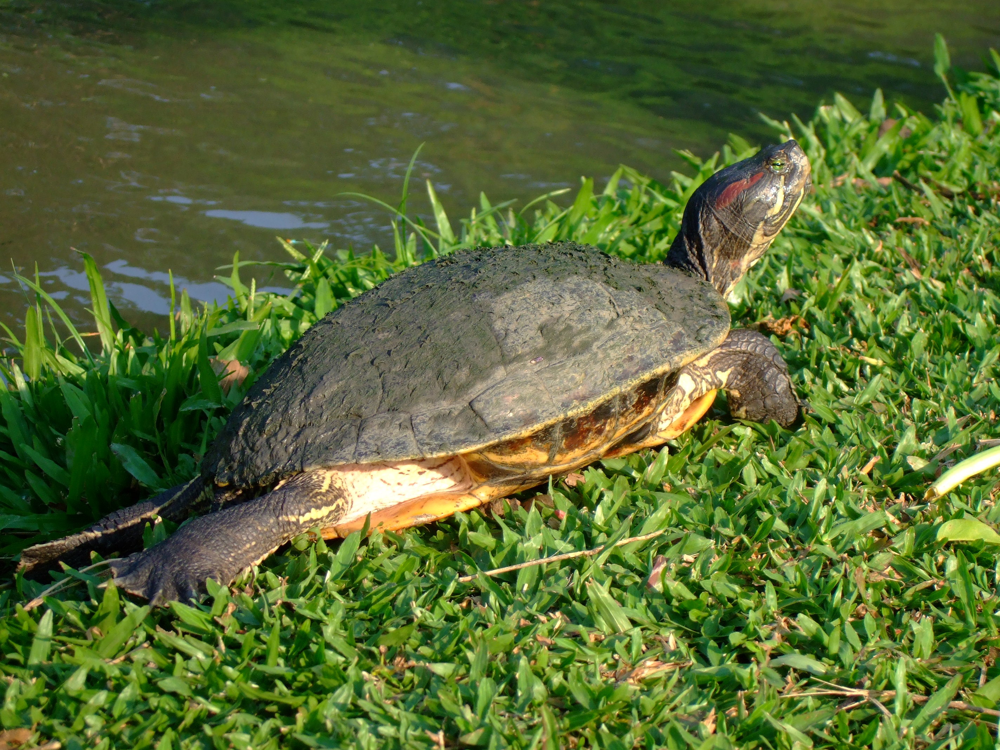

[('n01667114', 'mud_turtle', 0.8028461), ('n01667778', 'terrapin', 0.1782518), ('n01669191', 'box_turtle', 0.011918984)]


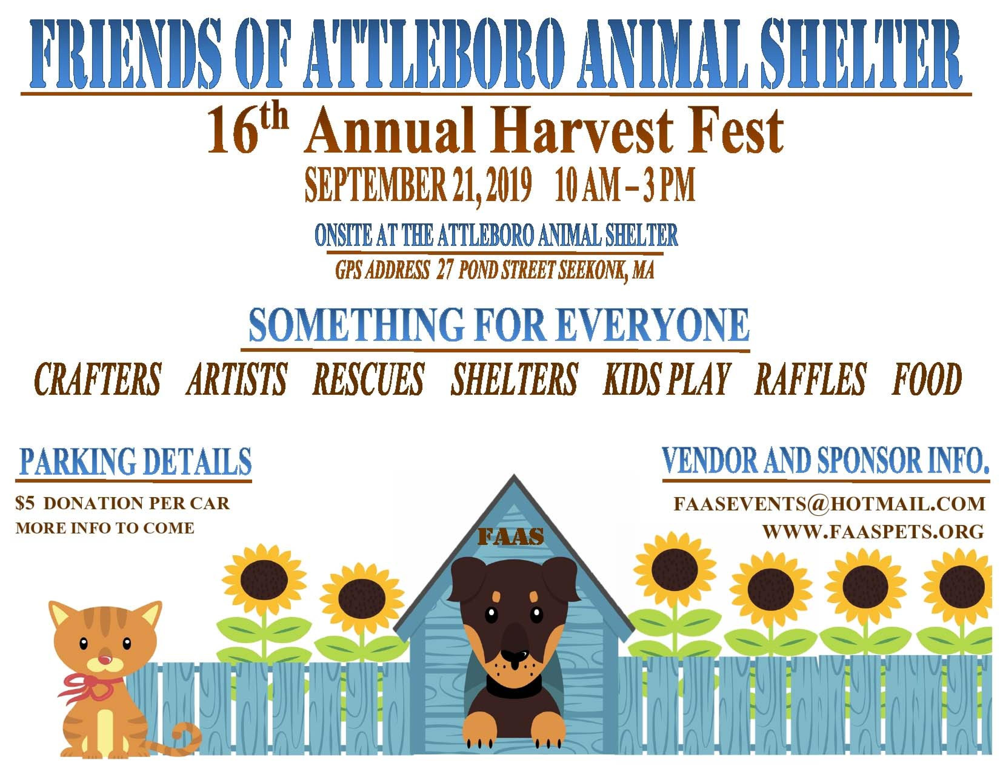

[('n06359193', 'web_site', 0.9318409), ('n06596364', 'comic_book', 0.022115933), ('n03291819', 'envelope', 0.011973337)]


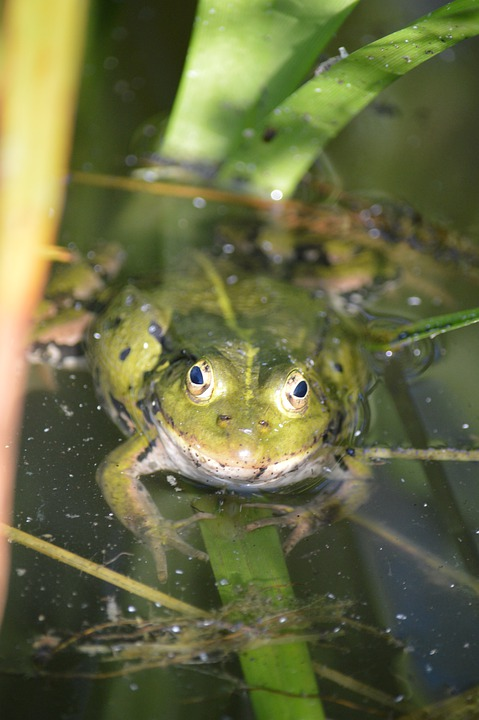

[('n01641577', 'bullfrog', 0.9931827), ('n01644900', 'tailed_frog', 0.006531384), ('n01644373', 'tree_frog', 0.00025668988)]


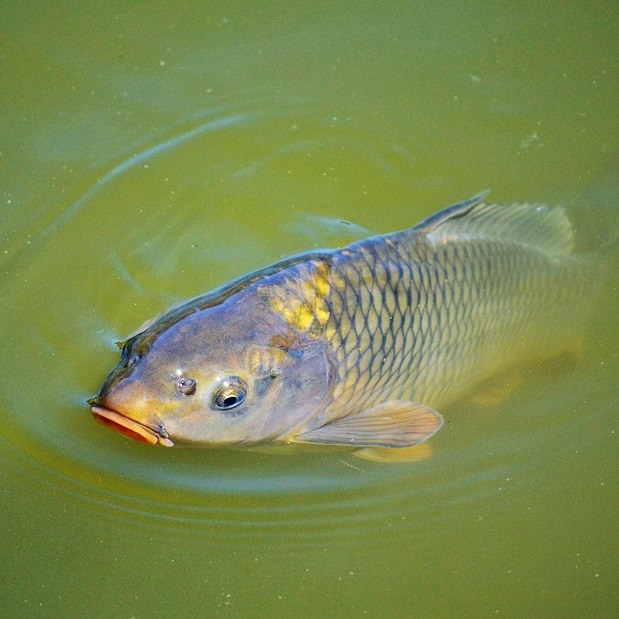

[('n01440764', 'tench', 0.798648), ('n02640242', 'sturgeon', 0.04803734), ('n02514041', 'barracouta', 0.033588663)]


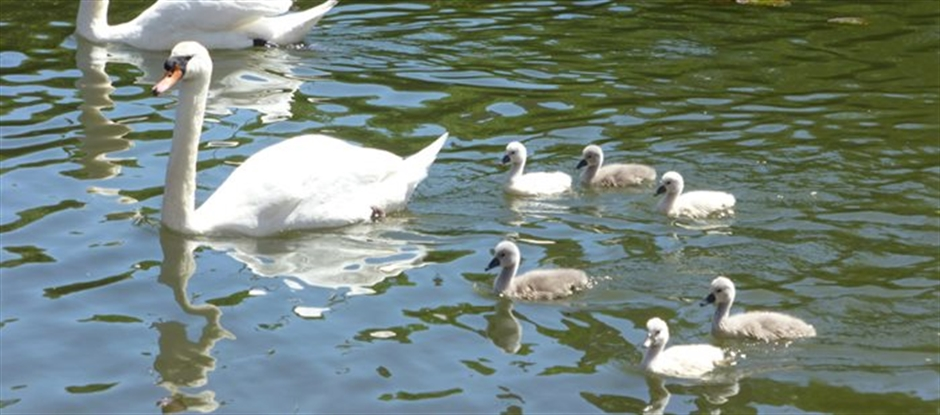

[('n02006656', 'spoonbill', 0.47829226), ('n02009912', 'American_egret', 0.18100509), ('n01860187', 'black_swan', 0.123377785)]


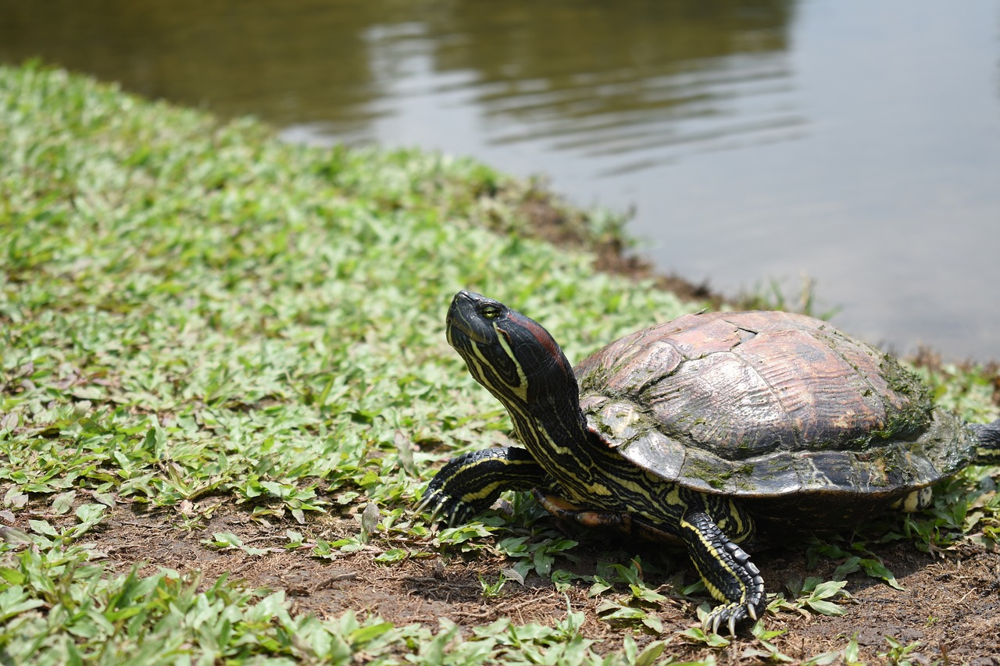

[('n01667114', 'mud_turtle', 0.90776664), ('n01667778', 'terrapin', 0.09090223), ('n01669191', 'box_turtle', 0.0013280456)]


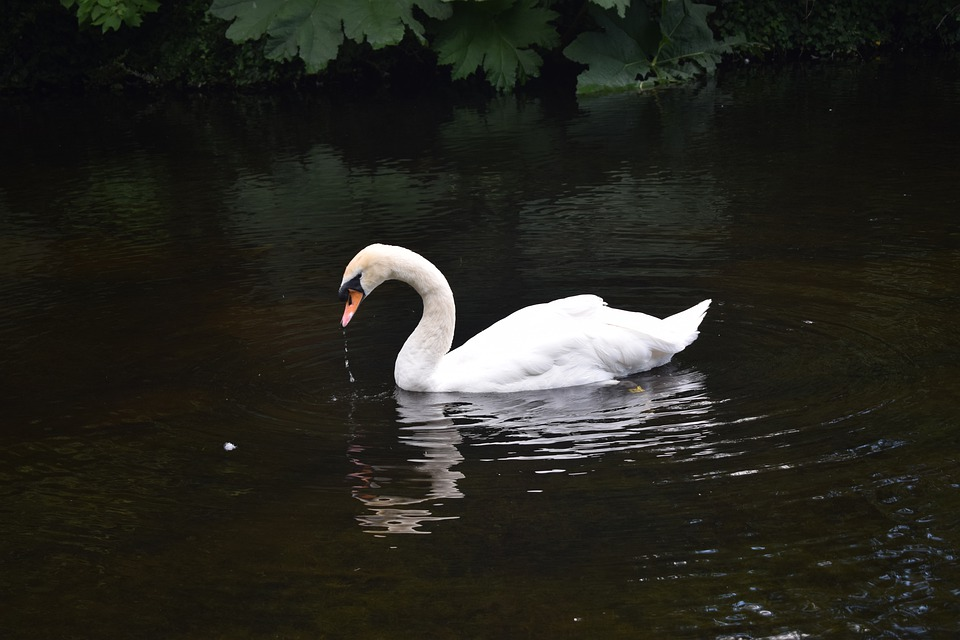

[('n02009912', 'American_egret', 0.5660207), ('n01855672', 'goose', 0.14357397), ('n02007558', 'flamingo', 0.11559939)]


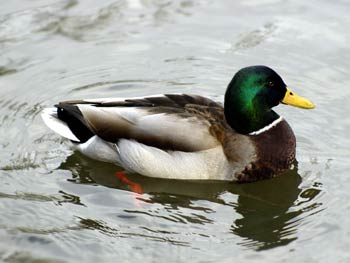

[('n01847000', 'drake', 0.9996997), ('n01855032', 'red-breasted_merganser', 0.00021216608), ('n01855672', 'goose', 2.355486e-05)]


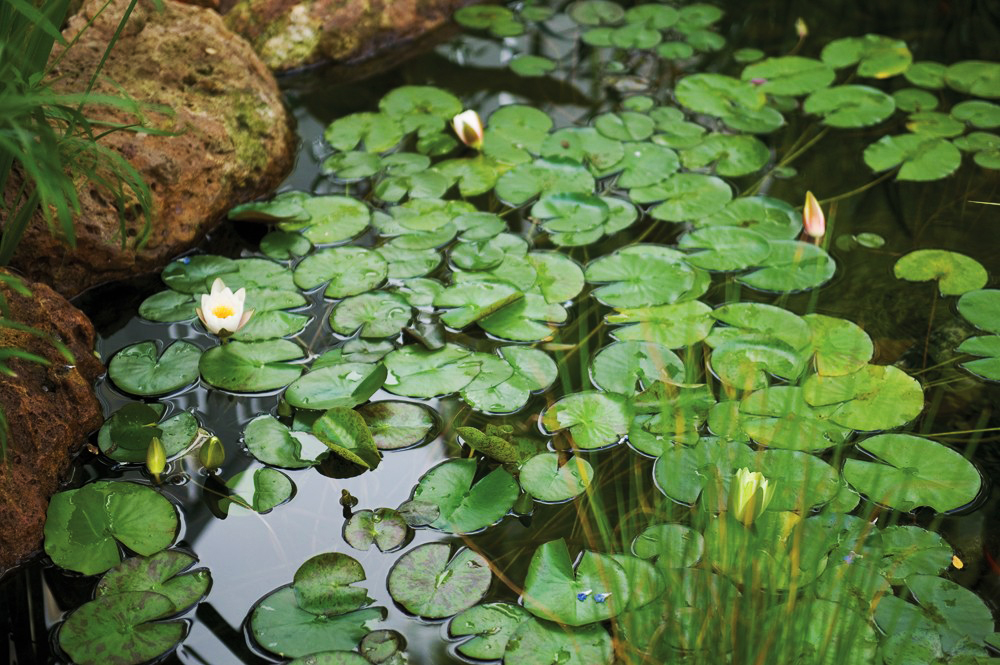

[('n01641577', 'bullfrog', 0.50503445), ('n04326547', 'stone_wall', 0.13743435), ('n03991062', 'pot', 0.07045273)]


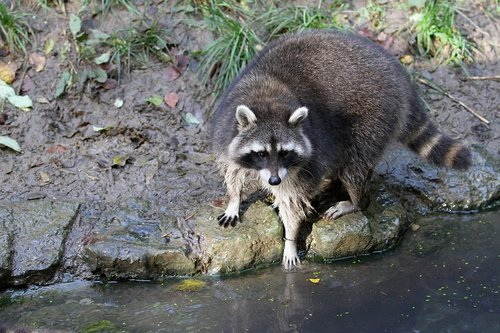

[('n02447366', 'badger', 0.21711928), ('n01877812', 'wallaby', 0.19386476), ('n01882714', 'koala', 0.0655902)]


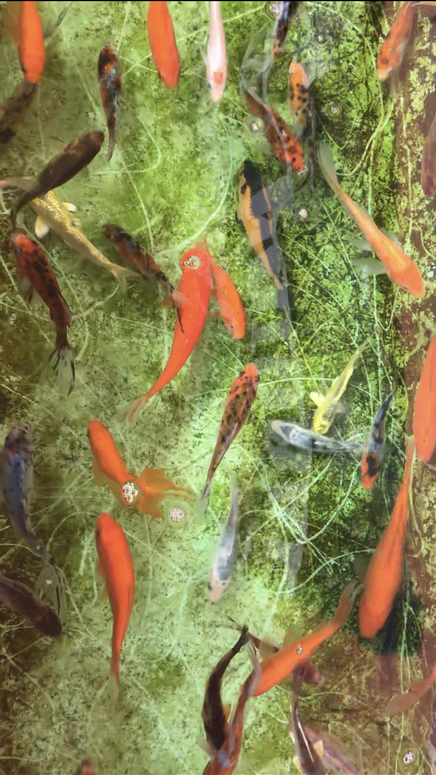

[('n01443537', 'goldfish', 0.99960405), ('n02007558', 'flamingo', 7.101759e-05), ('n01631663', 'eft', 6.2265426e-05)]


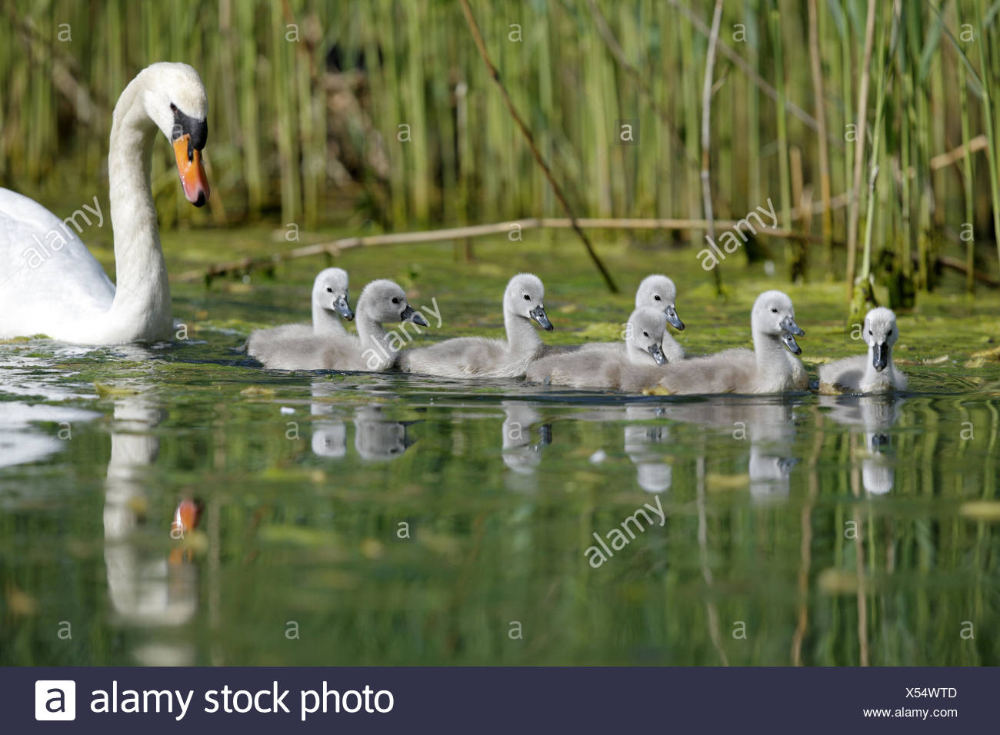

[('n01860187', 'black_swan', 0.74715286), ('n02009912', 'American_egret', 0.07295622), ('n01855672', 'goose', 0.050923783)]


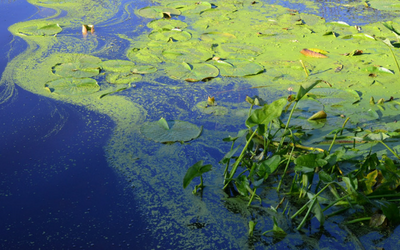

[('n09256479', 'coral_reef', 0.5138498), ('n10565667', 'scuba_diver', 0.10673225), ('n01910747', 'jellyfish', 0.084393285)]


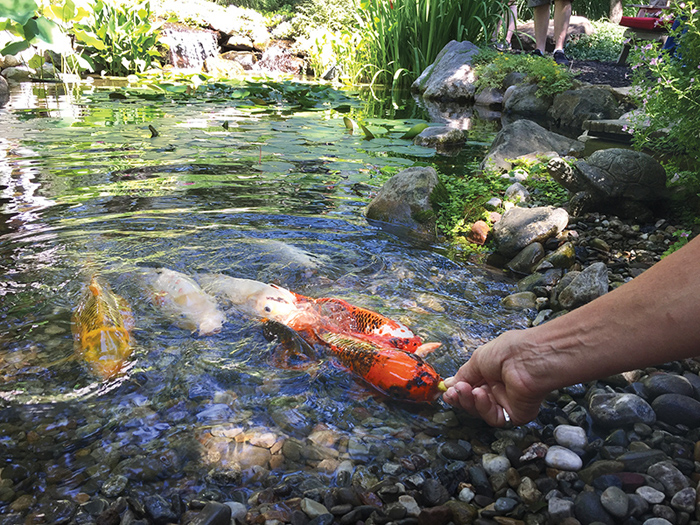

[('n02317335', 'starfish', 0.87617224), ('n01978455', 'rock_crab', 0.100157045), ('n01443537', 'goldfish', 0.007590749)]


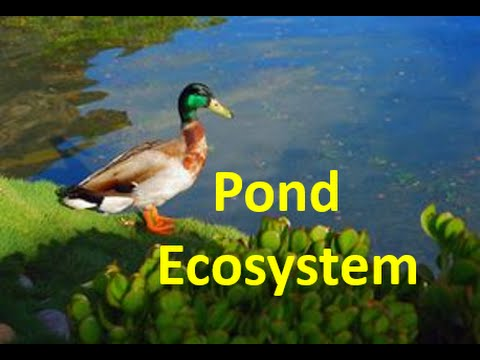

[('n04404412', 'television', 0.52426183), ('n01847000', 'drake', 0.18280195), ('n04152593', 'screen', 0.0891271)]


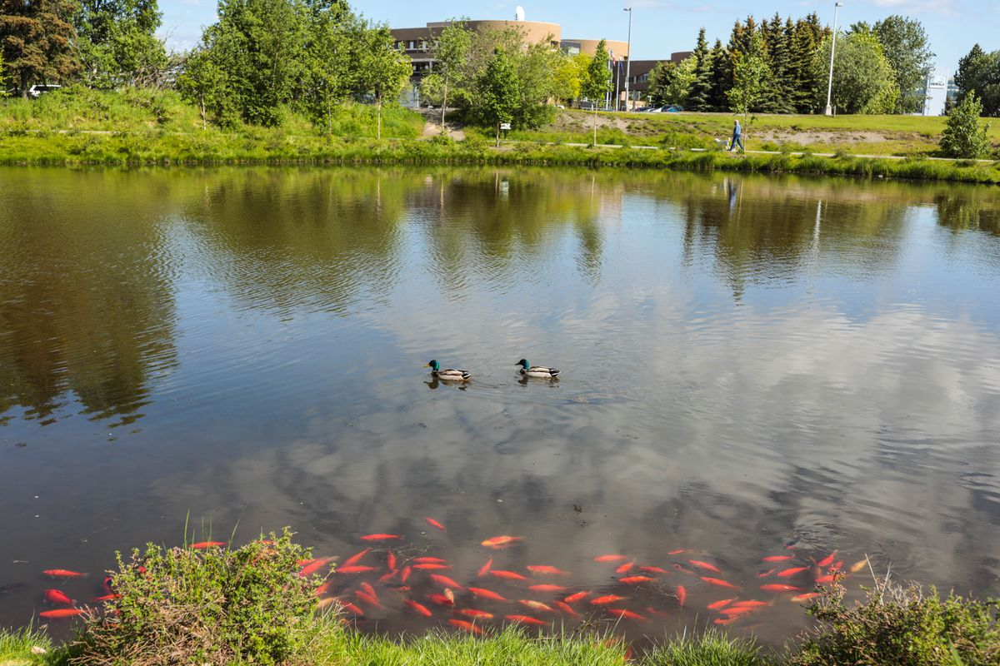

[('n09332890', 'lakeside', 0.35417205), ('n09468604', 'valley', 0.11817422), ('n02951358', 'canoe', 0.08043555)]


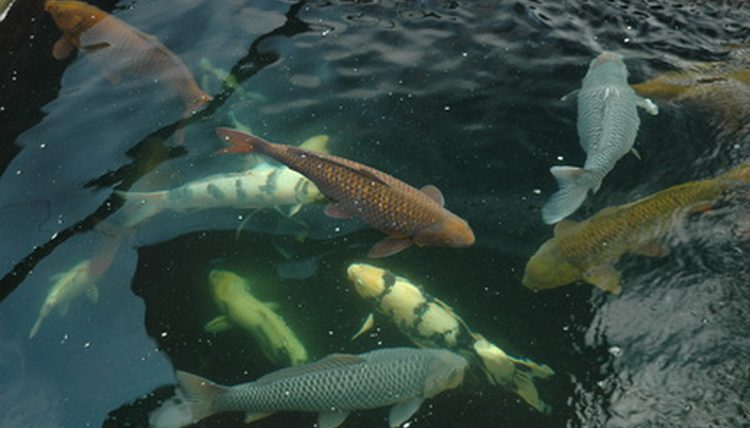

[('n01664065', 'loggerhead', 0.3622306), ('n02640242', 'sturgeon', 0.14692076), ('n01665541', 'leatherback_turtle', 0.08088086)]


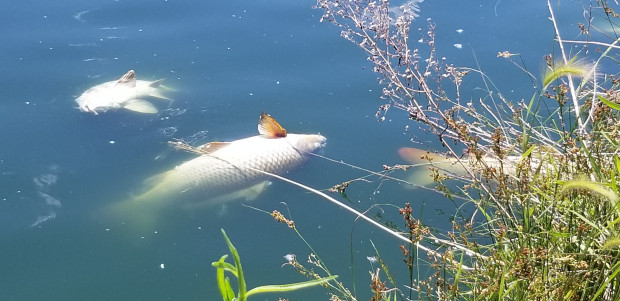

[('n02051845', 'pelican', 0.33185107), ('n02058221', 'albatross', 0.21766147), ('n01484850', 'great_white_shark', 0.11914189)]


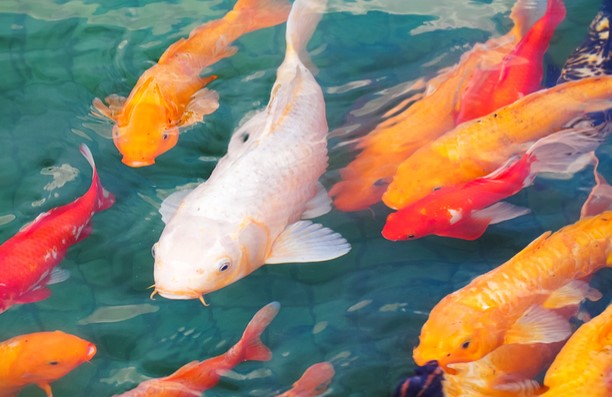

[('n01443537', 'goldfish', 0.99998975), ('n02007558', 'flamingo', 4.1442686e-06), ('n02536864', 'coho', 2.0842824e-06)]


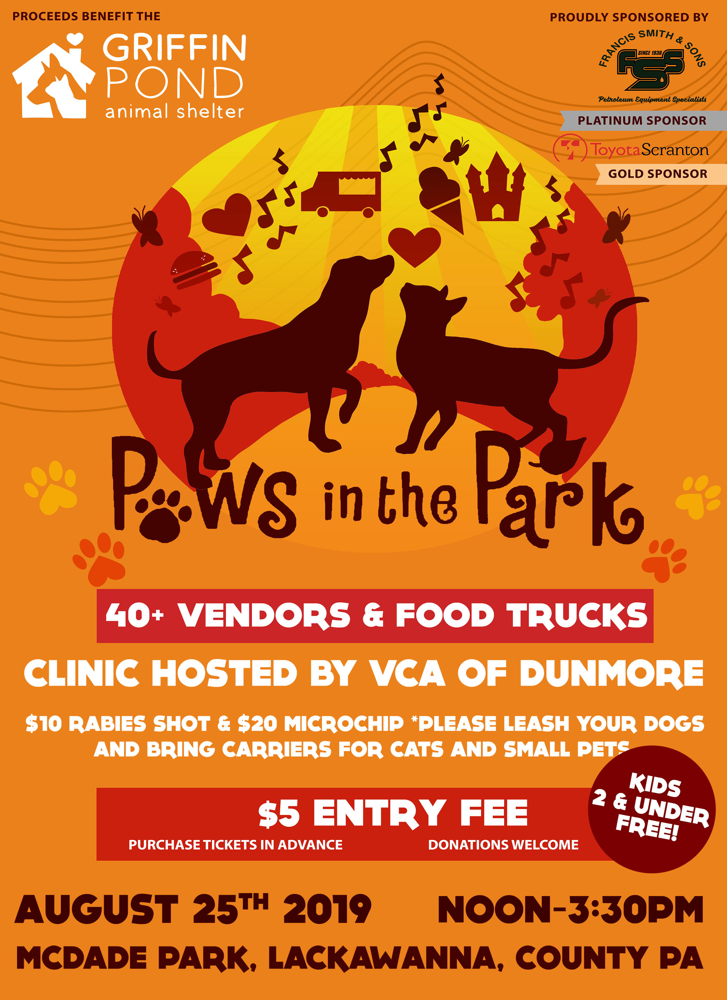

[('n07565083', 'menu', 0.79863364), ('n06359193', 'web_site', 0.19527863), ('n03291819', 'envelope', 0.0029607834)]


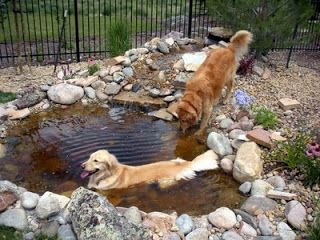

[('n02099601', 'golden_retriever', 0.27120134), ('n02098105', 'soft-coated_wheaten_terrier', 0.14891848), ('n02104029', 'kuvasz', 0.08105279)]


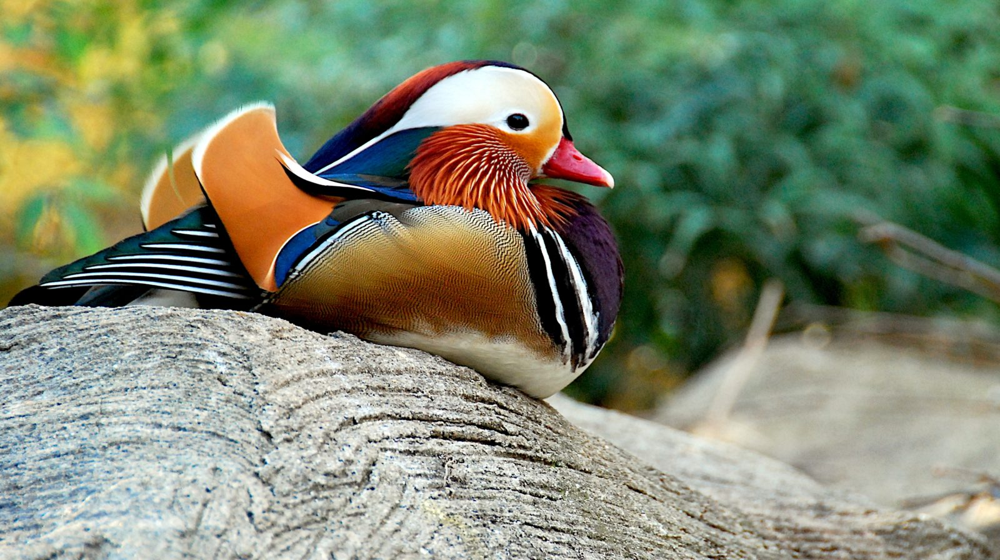

[('n01847000', 'drake', 0.9050117), ('n01797886', 'ruffed_grouse', 0.007405375), ('n01798484', 'prairie_chicken', 0.0055870907)]


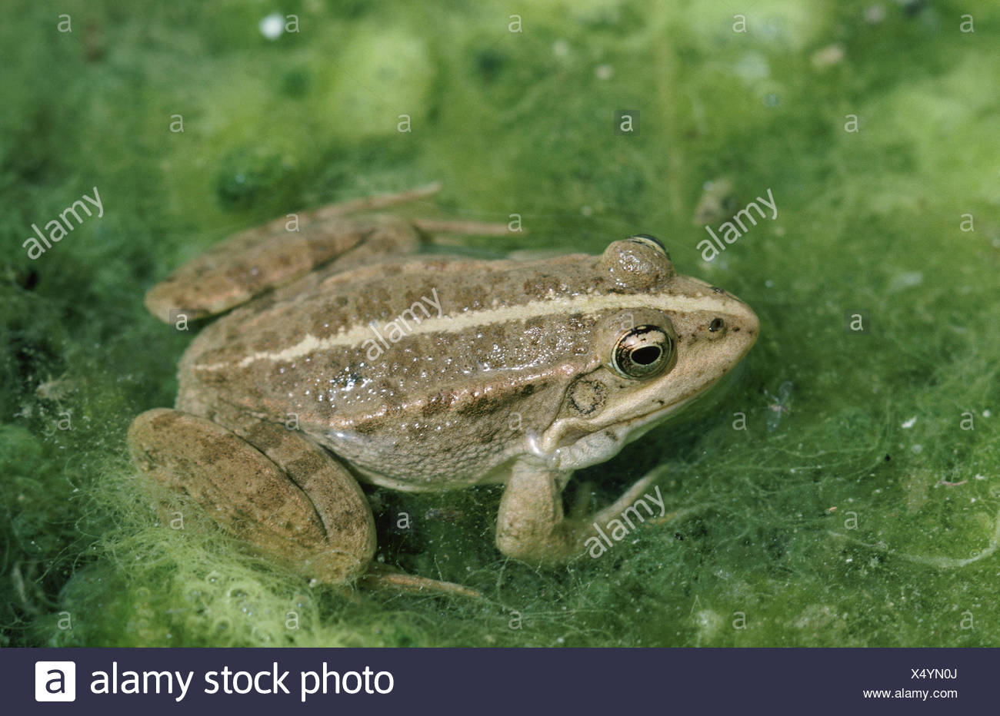

[('n01644900', 'tailed_frog', 0.90325046), ('n01641577', 'bullfrog', 0.089291066), ('n01644373', 'tree_frog', 0.007440578)]


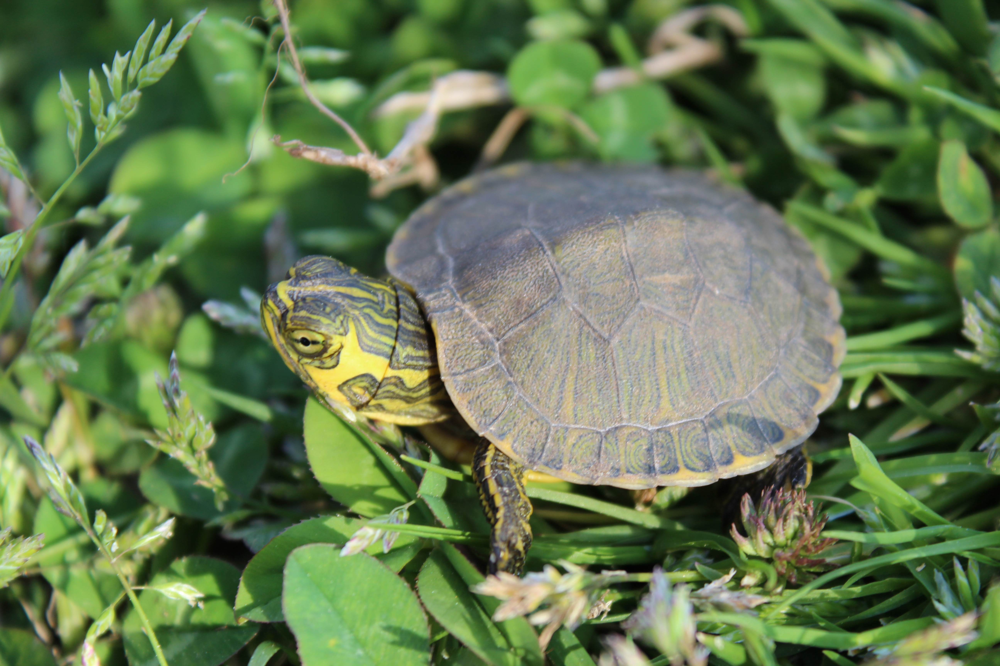

[('n01667114', 'mud_turtle', 0.48693565), ('n01669191', 'box_turtle', 0.33016473), ('n01667778', 'terrapin', 0.1801985)]


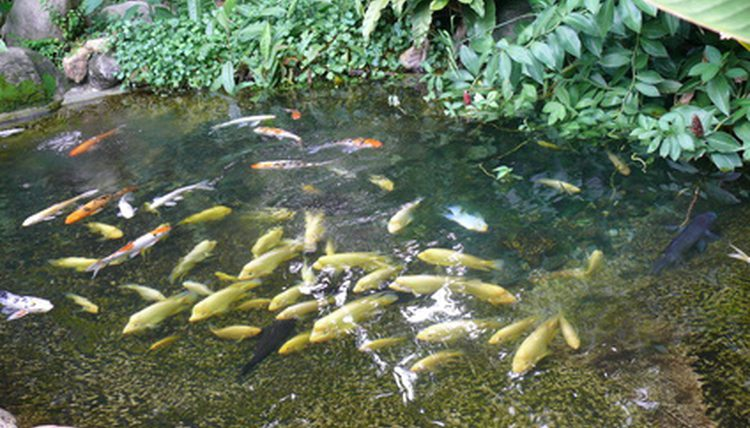

[('n09256479', 'coral_reef', 0.6771452), ('n01440764', 'tench', 0.06610917), ('n11939491', 'daisy', 0.062312)]


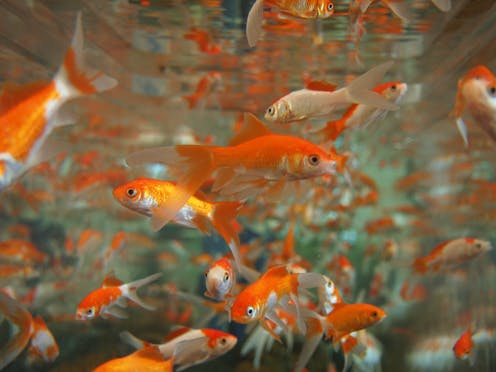

[('n01443537', 'goldfish', 0.9999845), ('n02607072', 'anemone_fish', 6.249694e-06), ('n09256479', 'coral_reef', 3.2586565e-06)]


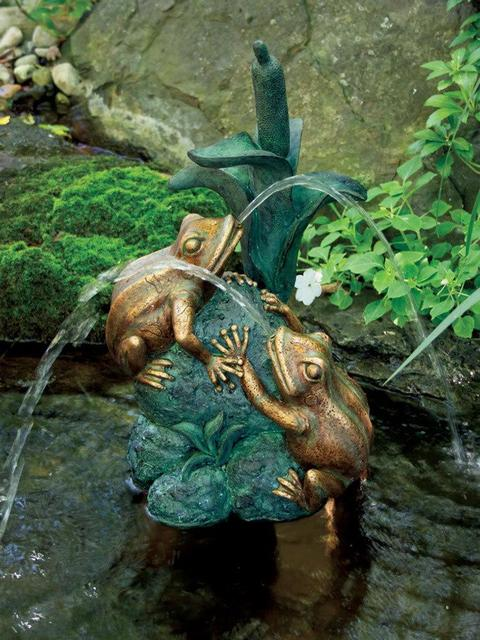

[('n01667778', 'terrapin', 0.31921878), ('n01641577', 'bullfrog', 0.29726836), ('n01644900', 'tailed_frog', 0.101246335)]


In [43]:
# TODO - your code!

import numpy as np
from keras.applications.resnet50 import ResNet50
from keras.preprocessing import image
from keras.applications.resnet50 import preprocess_input, decode_predictions

from IPython.display import Image

def process_img_path(img_path):
  return image.load_img(img_path, target_size=(224, 224))

def img_list_predict(img_list):
  model = ResNet50(weights='imagenet')
  for img_url in img_list:
    display(Image(filename=img_url, width=600))
    img = process_img_path(img_url)
    x = image.img_to_array(img)
    x = np.expand_dims(x, axis=0)
    x = preprocess_input(x)
    features = model.predict(x)
    results = decode_predictions(features, top=3)[0]
    print(results)
  return

images = absolute_image_paths[0]['animal pond']
img_list_predict(images)

<a id="p3"></a>
## Part 3 - Generative Adverserial Networks (GANS)

Describe the difference between a discriminator and generator in a GAN in your own words.

__*Your Answer:*__ 

#### Generator ####
A generator creates an image from noise and tries to fool the discriminator in thinking that it is a real image.

#### Discriminator ####
The job of a discriminator is to look at the image and be able to tell it from real to fake

How GAN works is the generator creates image by taking in random numbers/vectors. The image is then fed into the discrimnator along with other images taken from the actual dataset. It the nreturns probability between 0 and 1 of whether it is fake or not with 0 representing a fake and 1 representing an authentic image. Generator tries to get better at creating images and discriminator is trying to get better at identifying them as authentic or fake. The goal of the model is to get to the point where the generator can create images/input/features that cannot be identified as fake by the discrminator i.e. they look as real as belonging to the dataset that it is trained on.


<a id="p4"></a>
## Part 4 - More...

Answer the following questions, with a target audience of a fellow Data Scientist:

- What do you consider your strongest area, as a Data Scientist?
- What area of Data Science would you most like to learn more about, and why?
- Where do you think Data Science will be in 5 years?
- What are the treats posed by AI to our society?
- How do you think we can counteract those threats? 
- Do you think achieving General Artifical Intelligence is ever possible?

A few sentences per answer is fine - only elaborate if time allows.

So far, I have had the most fun with neural networks and all the remarkable things you can do with them. I wouldn't say that is my strongest area but it is definitely the area I want to advance in and master. I would love to learn more about object detection and computer vision, partially because I want a Knight Rider like car that takes me places and partially because I can envision many practical applications of it from helping in surgeries to self-driving cars. I believe data science can really change the world and society for the better if put to good use. Right now, there is a lot of hype around the field and a lot of companies have to figure out how to use it in the best way possible. But if it is not used for malicious intent, it could produce great solution to a lot of problems that exist in our society like poverty, inequality, injustice, poor health, and many more. 

The question ofwhether AI poses threats to the society can only be answered if we know who is it controlled by. If it is facial recognition software to help police officers identify past convicts in a robbery, then it could be very beneficial. But if it to give them drones to spy on poor/crime ridden neighborhoods like they do in Baltimore, then it can be seen as a threat to personal space, freedom and privacy. Same goes for all the projects that big companies like Google, Facebook, Microsoft are working on. One of the biggest threats that you can envision is development of skynet like programs. We already have DARPA funding research on autonomous weapons and despite the outcry by activists demanding more regulation, it has been going on. 

The only way to counteract these and other unseen or unfathomable threats is to regulate the field by an overseeing authority. I would not recommend stopping the research or advances in the field of AI because as mentioned above, it could potentially benefit humanity in a lot of ways. But there need to be an overseeing committee that ensures that all the research that is being done is for the greater good. A committee that has authority to oversee projects going on anywhere in the world would be the best solution so there is no prisoner's dilemma for one country vs. another to use AI research for malicious intents. 

While I would love to have a Terminator like companion, I don't think it is entirely possible to the point where a machine can mimic every human emotion. If we want to think of ourselves as robots, which we are in many ways i.e. being told to conform to the society, going to school, getting a job, getting married, growing old. In a lot of ways, we are already like robots and sure, we can make any robots to do that. But having a machine that can perform all that plus mimic all the human emotions/subconscious is going to be complicated. While the machines can be great at one specific task like AlphaGo is great at Go and has surpassed humans in intelligence, having one specific machine to be great at everything has a long way to go. 

## Congratulations! 

Thank you for your hard work, and congratulations! You've learned a lot, and you should proudly call yourself a Data Scientist.


In [44]:
from IPython.display import HTML

HTML("""<iframe src="https://giphy.com/embed/26xivLqkv86uJzqWk" width="480" height="270" frameBorder="0" class="giphy-embed" allowFullScreen></iframe><p><a href="https://giphy.com/gifs/mumm-champagne-saber-26xivLqkv86uJzqWk">via GIPHY</a></p>""")